### <p style="text-align: right;"> &#9989; Put your name here.</p>

#### <p style="text-align: right;"> &#9989; Put your group member names here.</p>

# Day 23 In-Class Assignment: 2D FFT
<img src="https://qph.fs.quoracdn.net/main-qimg-624339741ca9d7809d1eb1d501f3169e" >
<p style="text-align: right;">Image from: https://www.quora.com/What-is-the-engineering-behind-the-tread-patterns-of-tires-How-are-they-designed</p>

1. **Scientific motivation** 
    - Engineering of Tire Treads
    - Image Filtering
2. **Modeling tools** 
    - 2D FFT
    - Data Visualization
3. **Programming concepts** 
    - Code Review
    - Code Stubbing
4. **Python Programming Concepts** 
    - Sci-py and Numpy
    
    

### Agenda for today's class

</p>

1. Review pre-class assignment
1. Masking 2D FFTs
1. Tire Treads

---
# 1. Review pre-class assignment

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from skimage import color
import numpy as np
import imageio
from ipywidgets import interact
import glob
from IPython.display import display, clear_output
import time

def show_animation(delay=0.01):
    fig = plt.gcf()
    time.sleep(delay)       # Sleep for half a second to slow down the animation
    clear_output(wait=True) # Clear output for dynamic display
    display(fig)            # Reset display
    fig.clear()             # Prevent overlapping and layered plots

def show_fft_image(im):
    f, (ax2, ax3) = plt.subplots(1, 2, figsize=(20,10))
    gray = color.rgb2gray(im);
    ax2.imshow(gray, cmap='gray')
    ax2.axis('equal')
    ax2.axis('off')
    ax2.set_title('gray image')
    Fs = np.fft.fft2(gray)
    F2 = np.fft.fftshift( Fs ) 
    psd2D = np.abs( F2 )#**2
    ax3.imshow( np.log10(psd2D))
    ax3.axis('equal')
    ax3.axis('off')
    ax3.set_title('frequency space')
    
def get_images(folder):
    return glob.glob(folder+"/*.j*")
    
def browsefft_image(filenames):
    sz = len(filenames)
    def view_fft(i):
        im = imageio.imread(filenames[i])
        show_fft_image(im)
        plt.title(filenames[i])
    interact(view_fft, i=(0,sz-1))

&#9989; **Do this:** Use the above functions to read and display the files in the ```./images/fft``` folder (you should have this already from doing the pre-class assignment):


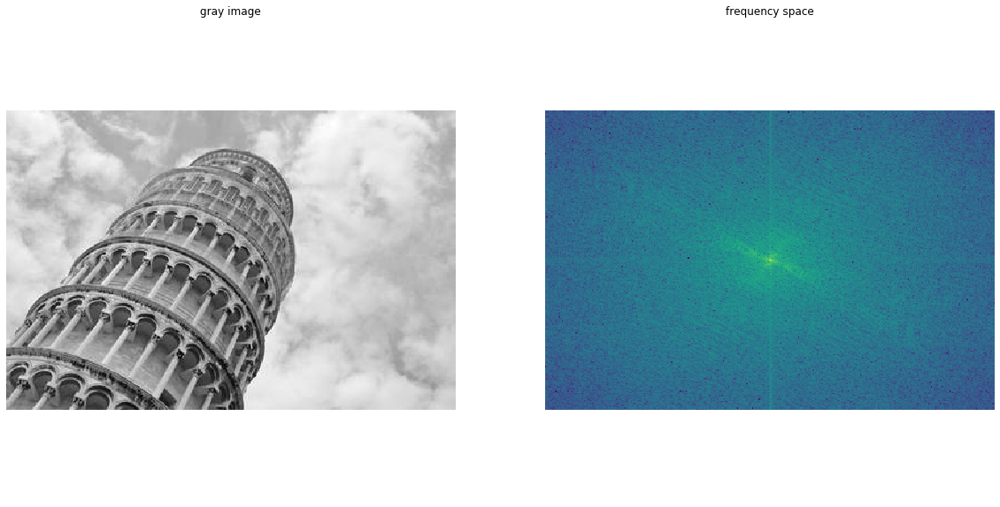

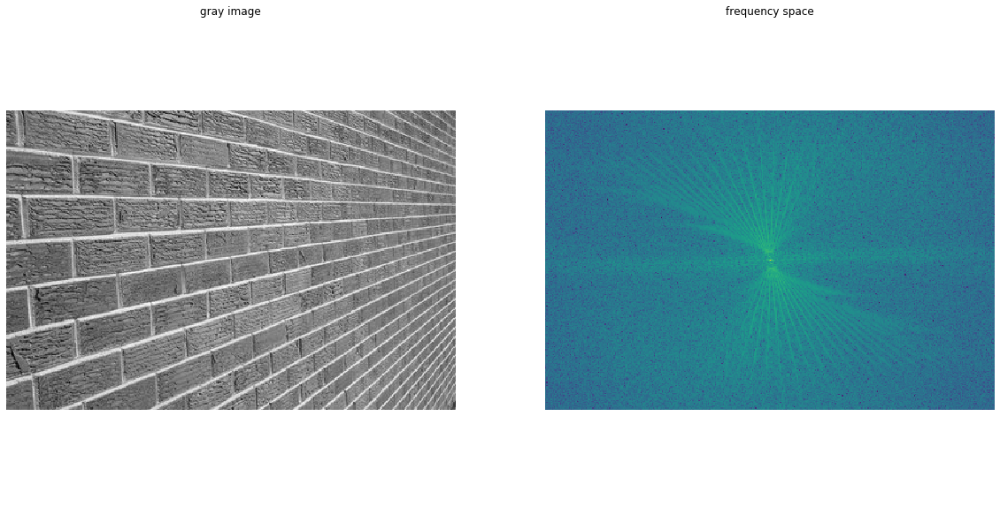

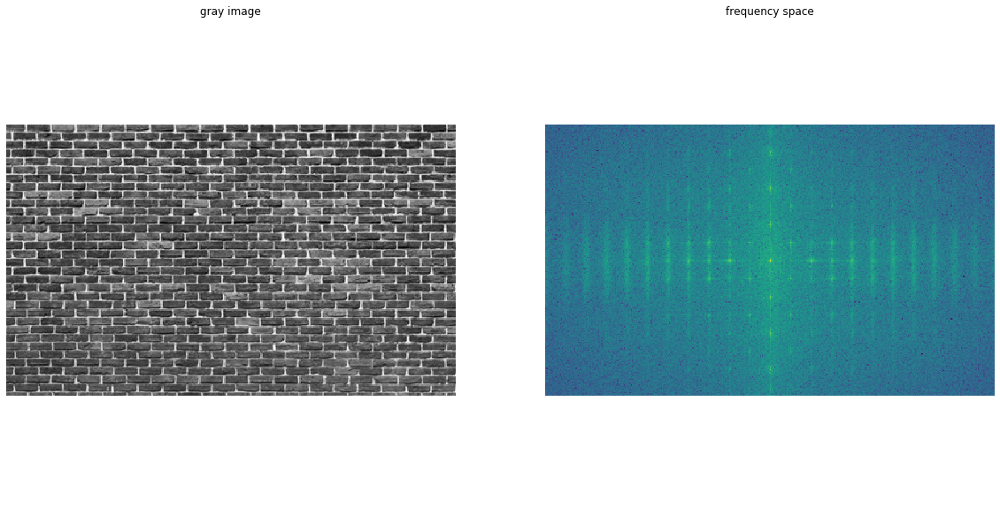

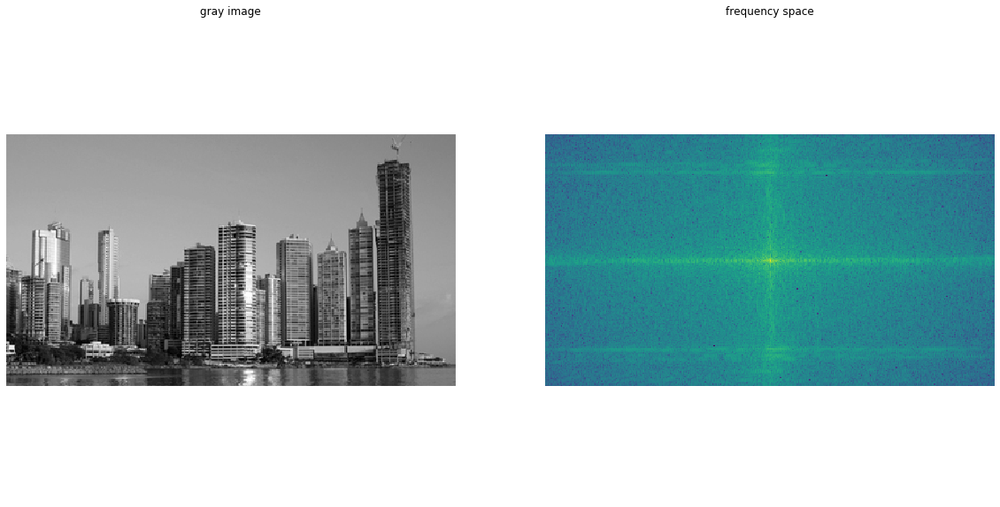

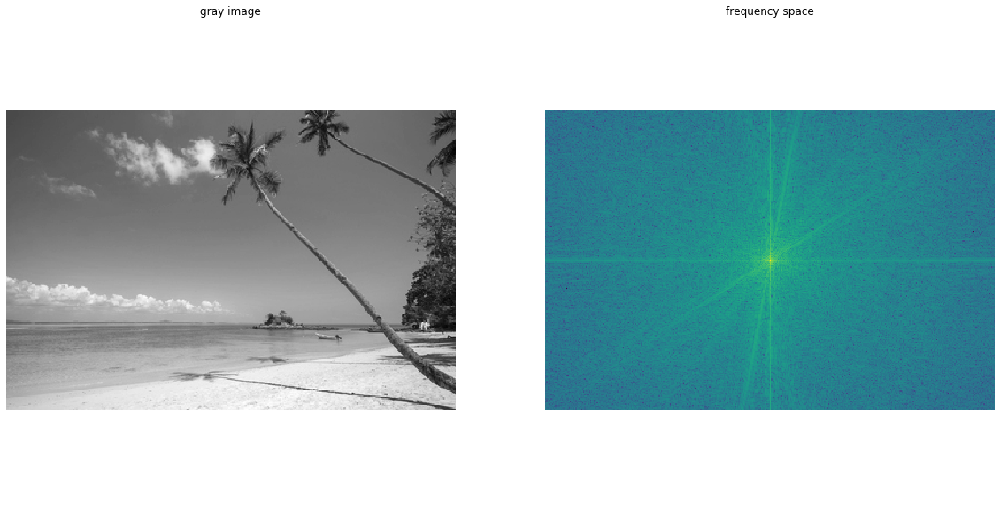

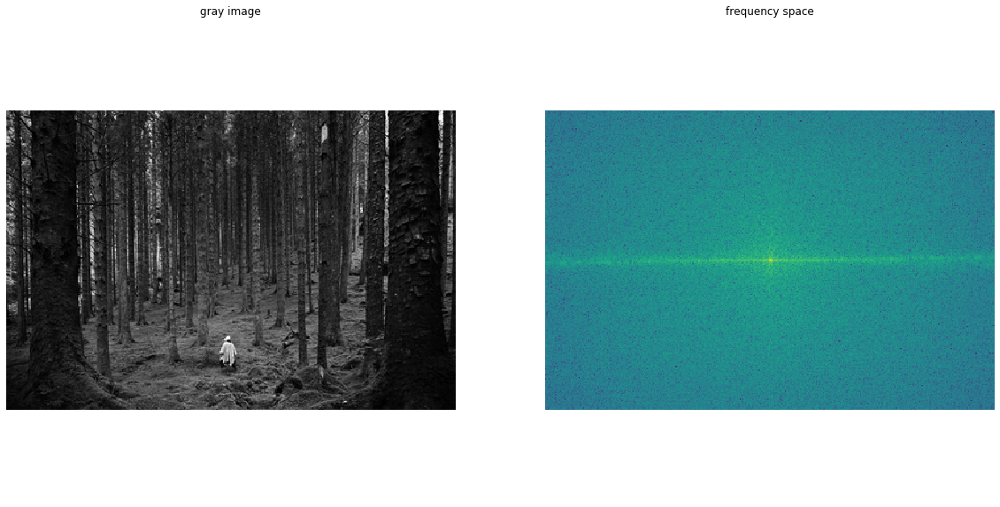

In [2]:
#Put your code here
# Put your code here
import os

for i in os.listdir('./images/fft'):
    if i.endswith(".jpeg") or i.endswith(".jpg"):
        pic = imageio.imread('./images/fft/'+ i)
        show_fft_image(pic)


**Question** Once you've got the image browser working, think about possible applications for 2D FFTs. We'll discuss these ideas as a class. Record your thoughts below and make notes of anything in the discussion that comes up that you think is particularly interesting:

<font size=8 color="#009600">&#9998;</font> Why does it seem like all of the 2D FFT go through the origin of the k-space?

----
# 2. Masking 2D FFTs
Lets see what changes when we play around a little with the 2D Fourier space. Review the following code with your group and complete the tasks below.

(-0.5, 249.5, 249.5, -0.5)

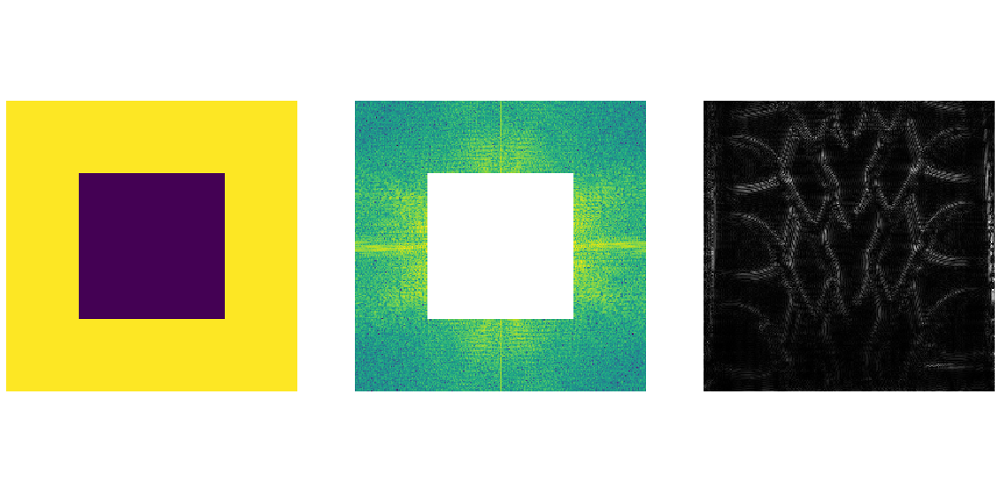

In [3]:
im = imageio.imread('./images/fft/tires/GoodrichCoupe.jpg')

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))

rows = im.shape[0]
cols = im.shape[1]

#Generate a simple square mask
mask = np.ones([rows,cols])

mask[round(rows/4):round(3*rows/4),round(cols/4):round(3*cols/4)] = 0

#Plot the mask
ax1.imshow(mask)
ax1.axis('equal')
ax1.axis('off')

#Calculate the Grayscale image
gray = color.rgb2gray(im);

# Take 2D FFT
Fs = np.fft.fft2(gray)

# Shift the 2D FFT into the "Standard" view
F2 = np.fft.fftshift( Fs ) 

#Apply the mask
F3 = F2*mask

# Generate easy-to-see plot
psd2D = np.abs( F3 )#**2
ax2.imshow( np.log10(psd2D))
ax2.axis('equal')
ax2.axis('off')

# Shift the masked image back
F4 = np.fft.fftshift( F3 ) 

# Apply the inverse fft and show the final result. 
im2 = abs(np.fft.ifft2(F4))
ax3.imshow(im2, cmap='gray')
ax3.axis('equal')
ax3.axis('off')

**Question:** In your own words describe the "mask" variable and what it is doing in the above example:

<font size=8 color="#009600">&#9998;</font> Do This - Erase the contents of this cell and replace it with your answer to the above question!  (double-click on this text to edit this cell, and hit shift+enter to save the text)

&#9989; **Do this:** Modify the above code to 'flip' the mask.  i.e. make the center area ones and the outer area zeros. 

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: RuntimeWarning: divide by zero encountered in log10


(-0.5, 249.5, 249.5, -0.5)

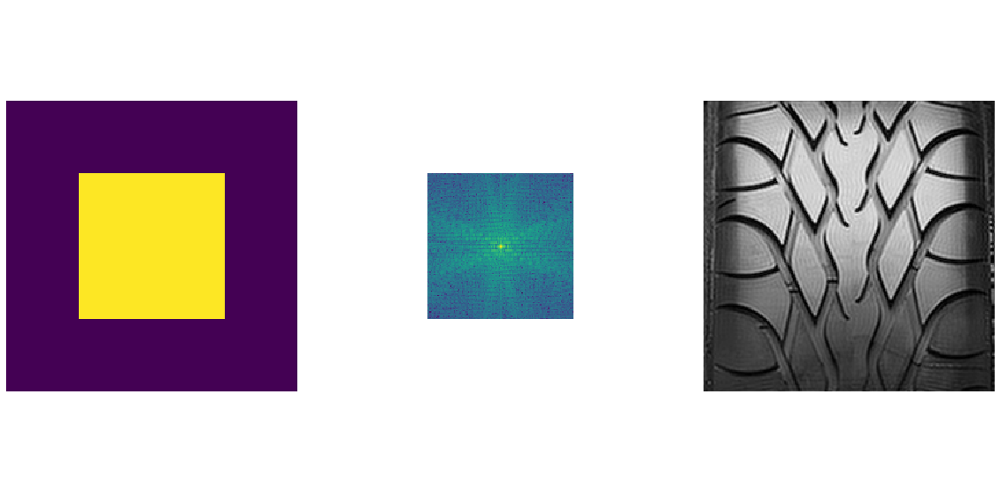

In [4]:
#Put your code here
im = imageio.imread('./images/fft/tires/GoodrichCoupe.jpg')

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))

rows = im.shape[0]
cols = im.shape[1]

#Generate a simple square mask
mask = np.zeros([rows,cols])

mask[round(rows/4):round(3*rows/4),round(cols/4):round(3*cols/4)] = 1

#Plot the mask
ax1.imshow(mask)
ax1.axis('equal')
ax1.axis('off')

#Calculate the Grayscale image
gray = color.rgb2gray(im);

# Take 2D FFT
Fs = np.fft.fft2(gray)

# Shift the 2D FFT into the "Standard" view
F2 = np.fft.fftshift( Fs ) 

#Apply the mask
F3 = F2*mask

# Generate easy-to-see plot
psd2D = np.abs( F3 )#**2
ax2.imshow( np.log10(psd2D))
ax2.axis('equal')
ax2.axis('off')

# Shift the masked image back
F4 = np.fft.fftshift( F3 ) 

# Apply the inverse fft and show the final result. 
im2 = abs(np.fft.ifft2(F4))
ax3.imshow(im2, cmap='gray')
ax3.axis('equal')
ax3.axis('off')


**Question:** How does this change the final image?  What does that tell you about the values in the center of the Fourier space compared to the ones at the edge?

<font size=8 color="#009600">&#9998;</font> The ones on the edge don't matter as much. The central values play a key role in image reconstruction

&#9989; **Do this:** Modify the above code to dynamically change the  masked region in some meaningful way. Use either a slider or animate the results. Your goal should be to make something that looks interesting and helps you understand what is going on in the frequency space.  We will be sharing our examples with the class. 

(-0.5, 249.5, 249.5, -0.5)

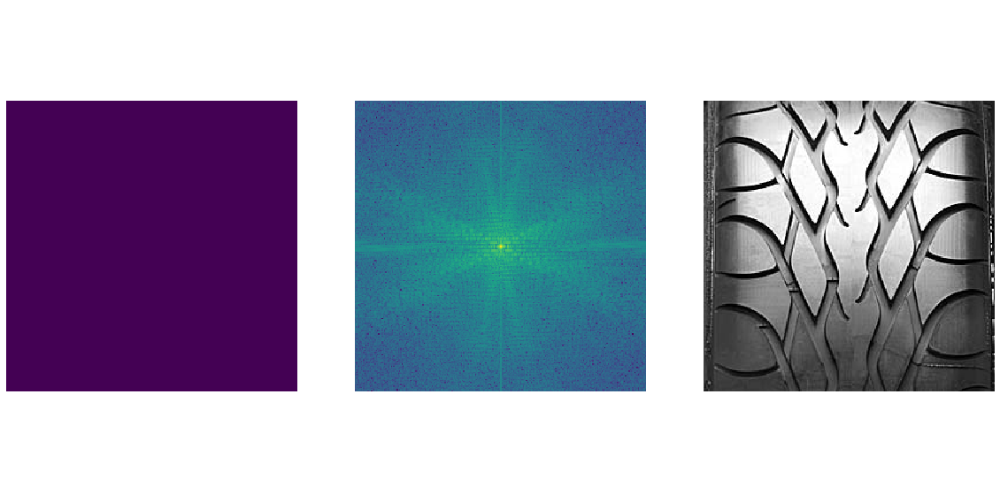

In [5]:
#Put your code here
im = imageio.imread('./images/fft/tires/GoodrichCoupe.jpg')

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))

rows = im.shape[0]
cols = im.shape[1]

#Generate a simple square mask
mask = np.ones([rows,cols])

mask[round(rows/4):round(rows/2),round(cols/2):round(2*cols/4)] = 0

#Plot the mask
ax1.imshow(mask)
ax1.axis('equal')
ax1.axis('off')

#Calculate the Grayscale image
gray = color.rgb2gray(im);

# Take 2D FFT
Fs = np.fft.fft2(gray)

# Shift the 2D FFT into the "Standard" view
F2 = np.fft.fftshift( Fs ) 

#Apply the mask
F3 = F2*mask

# Generate easy-to-see plot
psd2D = np.abs( F3 )#**2
ax2.imshow( np.log10(psd2D))
ax2.axis('equal')
ax2.axis('off')

# Shift the masked image back
F4 = np.fft.fftshift( F3 ) 

# Apply the inverse fft and show the final result. 
im2 = abs(np.fft.ifft2(F4))
ax3.imshow(im2, cmap='gray')
ax3.axis('equal')
ax3.axis('off')


----
# 4. Tire Treads (FFT Example)

In the US, car tread patterns are **copyrighted instead of being patented**. This means that when tire manufacturers design a new tire they need to check the tread to ensure it does not look like a similar tread already in existence. 

In this section we will design a pattern recognition system to use 2D FFTs to classify a tire. (In fact, CMSE Professor Dirk Colbry's [first paper](http://www.tiresciencetechnology.org/doi/abs/10.2346/1.2186784) did precisely this!)

&#9989; **Do this:** Use the function in part 1 to read and display the files in the ```./images/fft/tires``` folder:


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


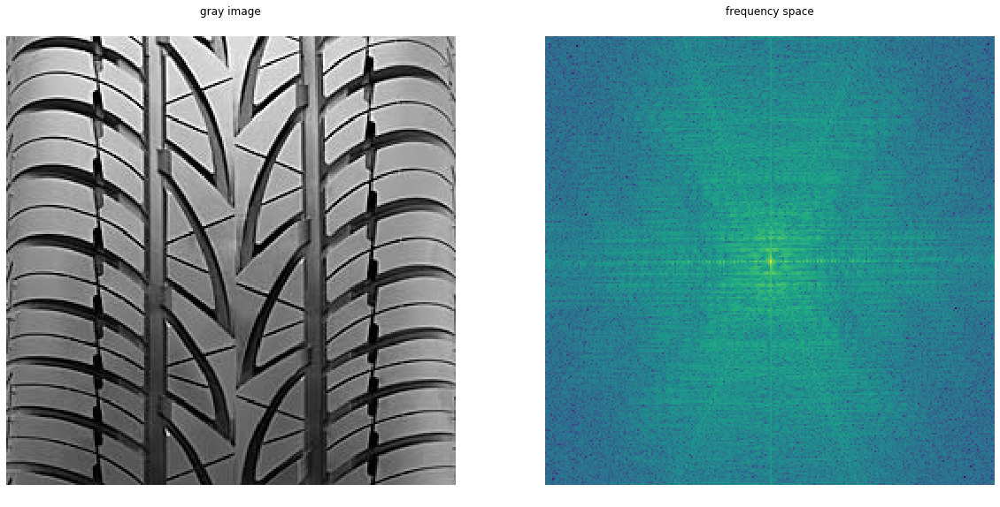

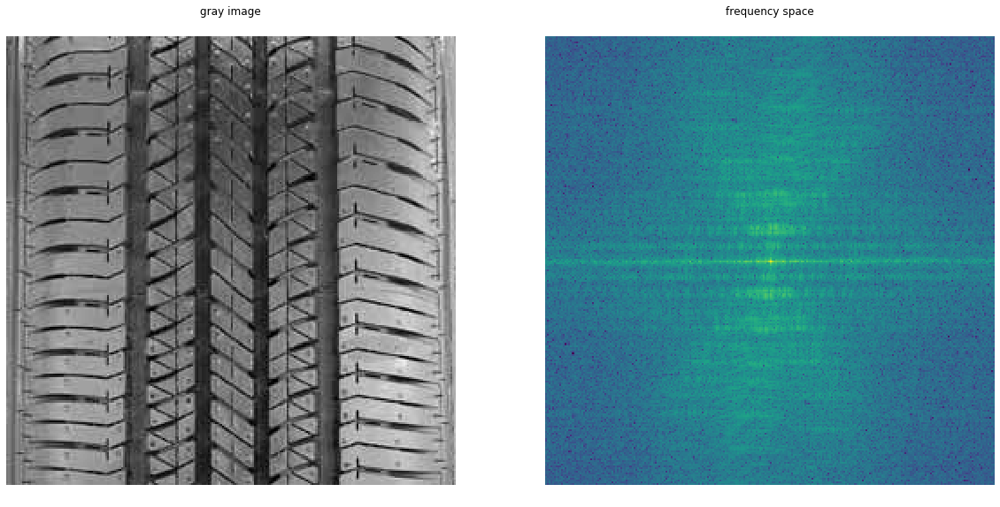

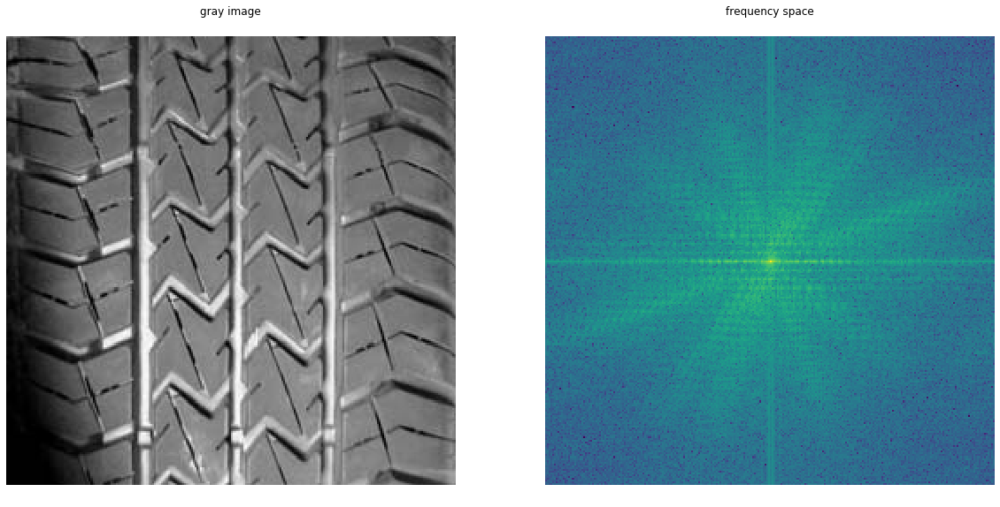

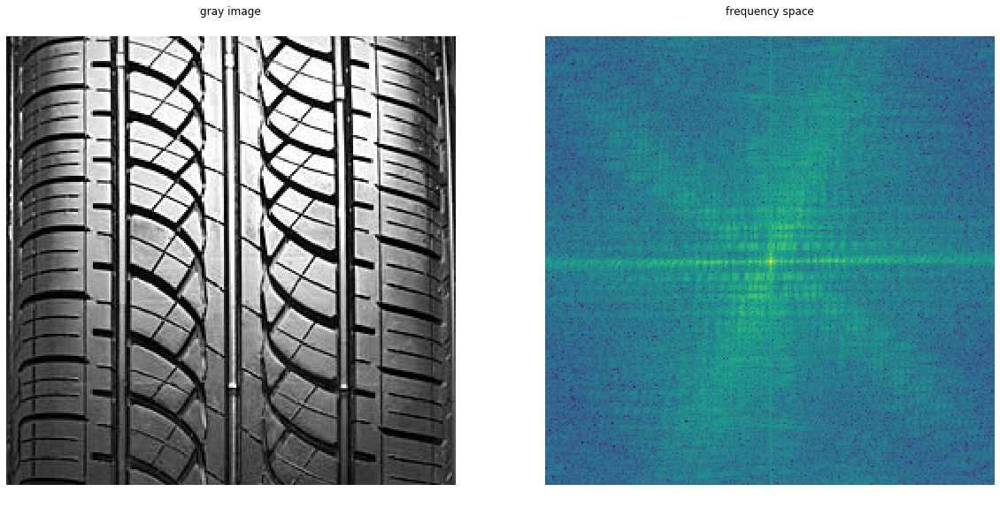

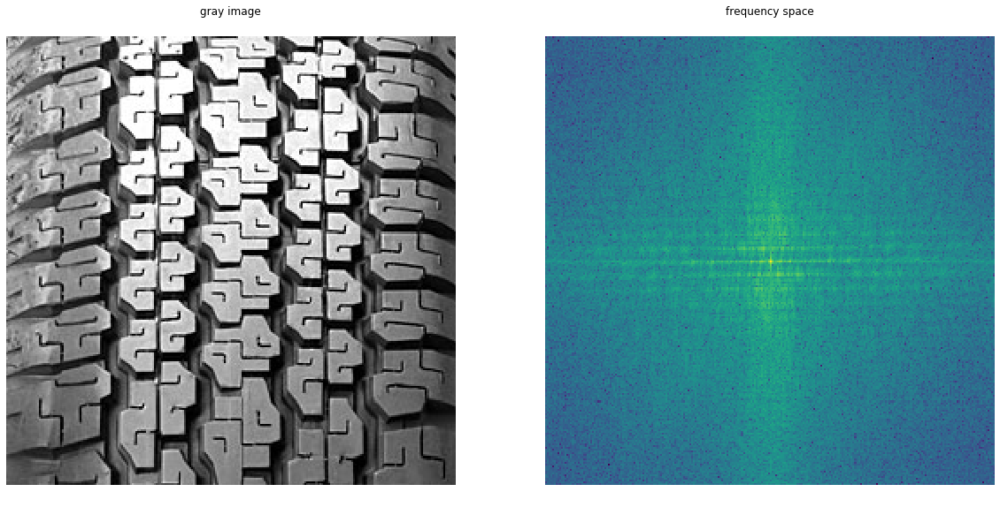

...

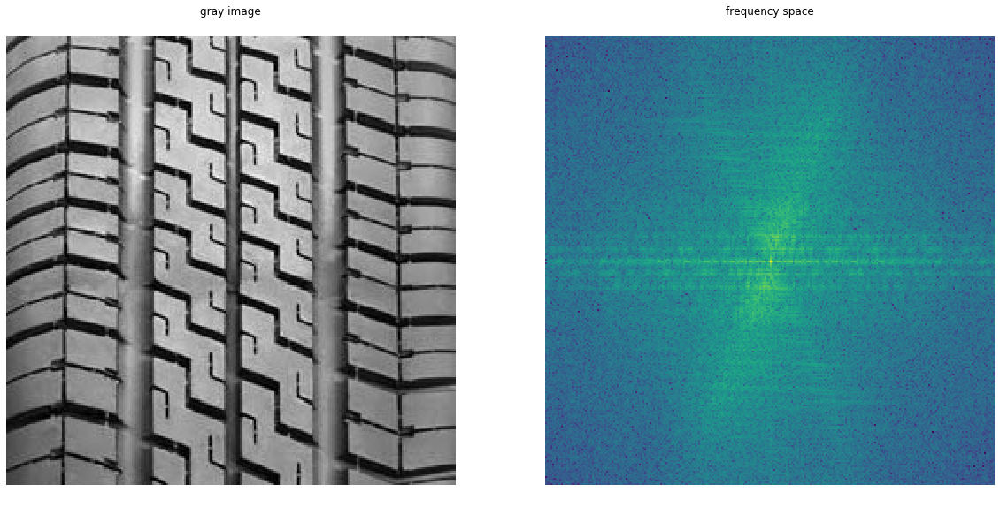

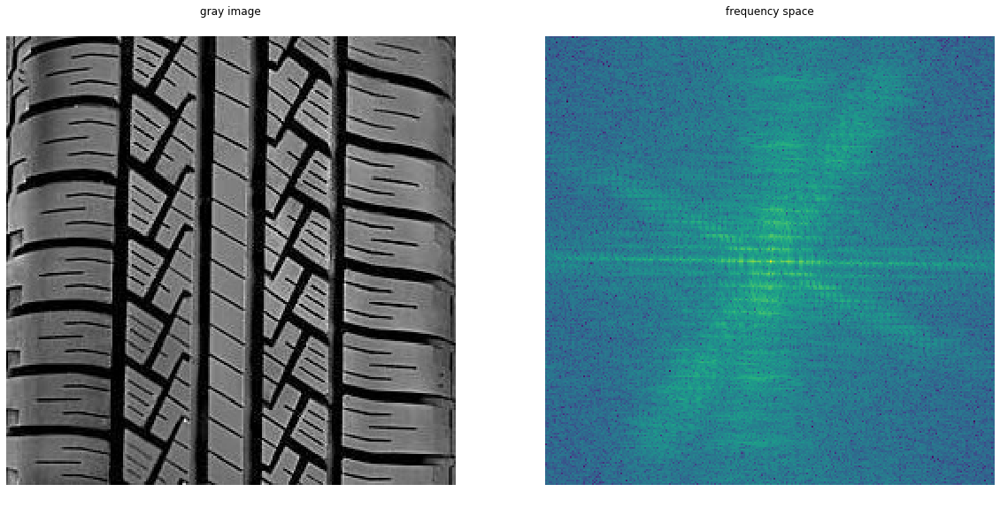

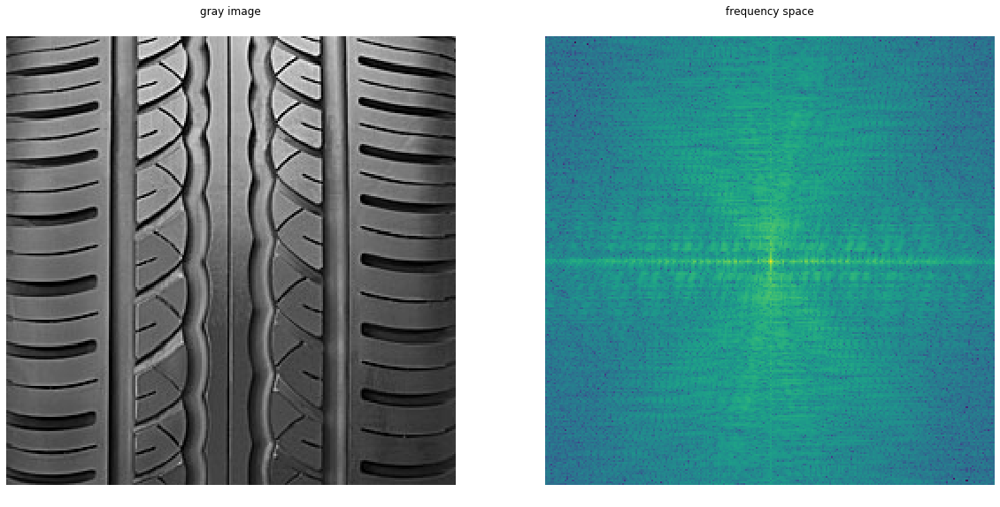

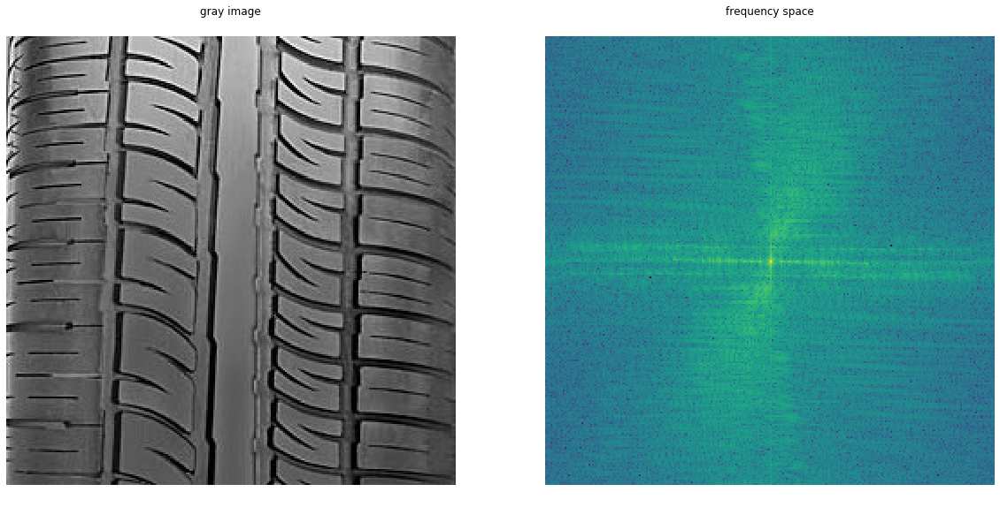

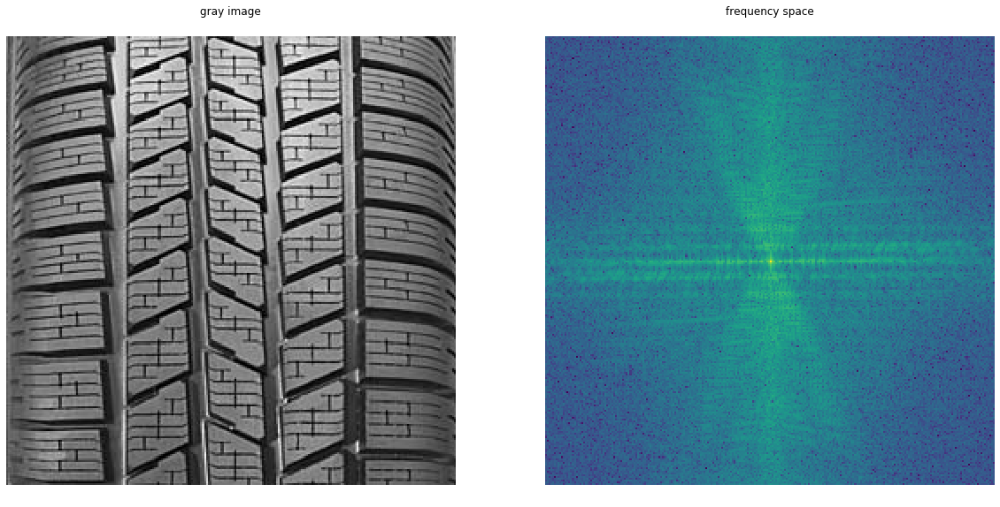

In [9]:
#Put your code here
for i in os.listdir('./images/fft/tires'):
    if i.endswith(".jpeg") or i.endswith(".jpg"):
        pic = imageio.imread('./images/fft/tires/'+ i)
        show_fft_image(pic)


&#9989; **Do this:** Break up into your groups and come up with an outline for a project for finding the k-nearest neighbors for tires that look the most similar. We will share your design with the class.  

# Put your stub code here (or, if you're feeling ambitious, feel free to try implementing a solution!)
0. Do a FFT of the tire images
1. Overlay the k-spaces of the tires
2. For each test value, find the nearest neighbors of all of it's neighbor points within 30 units. 
3. Classify via the most neighbors around.


----

-----
### Congratulations, we're done!

Now, you just need to submit this assignment by uploading it to the course <a href="https://d2l.msu.edu/">Desire2Learn</a> web page for today's submission folder(Don't forget to add your names in the first cell).


&#169; Copyright 2018,  Michigan State University Board of Trustees